In [1]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../m2vae/')

import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score
from IPython.display import Audio, display, HTML
import base64

import pretty_midi
import pypianoroll as ppr

import torch

import vis
import io_util
import wrappers
import util

In [2]:
EXP_DIR = '../exp/1track_no_kl_1mse'
DATA_FILE = '../data/train_x_lpd_5_phr_debug.npz'
args = io_util.parse_args('interactive', exp_dir=EXP_DIR, debug=True, data_file=DATA_FILE)

util.restore_args(args, EXP_DIR)

random = np.random.RandomState(args.seed)

dataloaders, pos_prop = wrappers.load_data(args, random_state=random,
                                           use_random_transpose=False)
model, optimizer, loss = wrappers.build_mvae(args, pos_prop=pos_prop)

util.restore_checkpoint(model, optimizer, args.exp_dir,
                        cuda=args.cuda,
                        filename='model_best.pth')

model.eval();

In [3]:
# Load one batch and pass through model
tracks = next(iter(dataloaders['val']))
tracks = tracks[:, :, :, :, :args.n_tracks]
with torch.no_grad():
    tracks_recon, z = model(tracks, return_z = True)

tracks_np = tracks.detach().cpu().numpy().astype(np.bool)
tracks_recon_np = (tracks_recon.detach().cpu().numpy() > 0.0)

print("This batch F1: {:.3f}".format(f1_score(tracks_np.flatten(), tracks_recon_np.flatten())))

This batch F1: 0.962


# Example Reconstructions

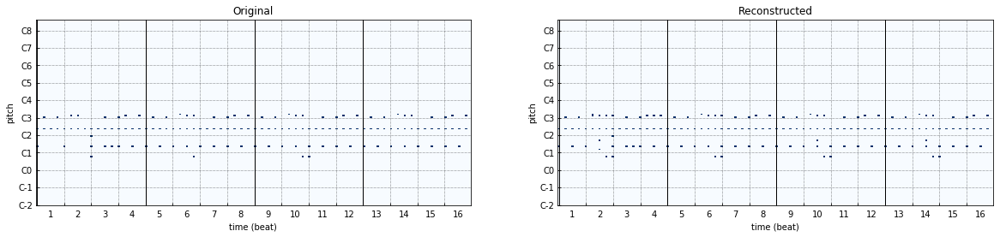

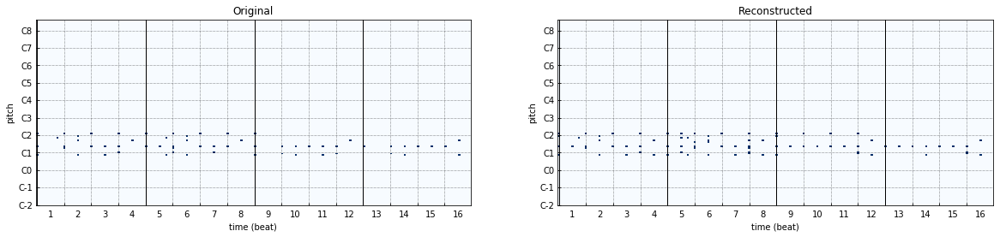

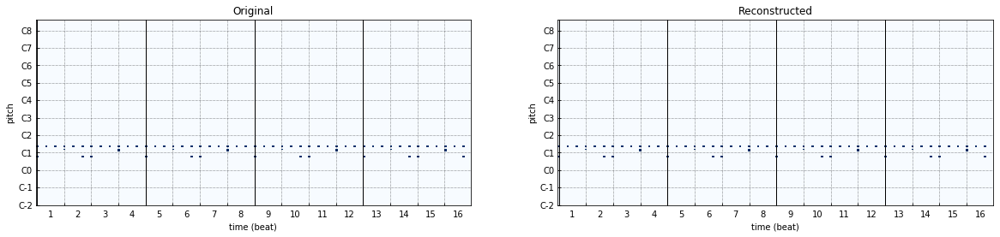

In [4]:
N_DISPLAY = 3
for track, track_recon, i in zip(tracks_np, tracks_recon_np, range(N_DISPLAY)):
    track = vis.to_track(track[:, :, :, 0], is_drum=True)
    track_recon = vis.to_track(track_recon[:, :, :, 0], is_drum=True)

    audio = vis.synthesize(track)
    audio_recon = vis.synthesize(track_recon)
    
    vis.ipy_display(audio, 'Original')
    vis.ipy_display(audio_recon, 'Reconstructed')

    f, axarr = plt.subplots(ncols=2, figsize=(20, 4))

    axarr[0].set_title('Original')
    axarr[1].set_title('Reconstructed')

    ppr.plot_pianoroll(axarr[0], track.pianoroll, beat_resolution=12, downbeats=vis.DOWNBEATS)
    ppr.plot_pianoroll(axarr[1], track_recon.pianoroll, beat_resolution=12, downbeats=vis.DOWNBEATS)

    plt.show()

# Interpolations

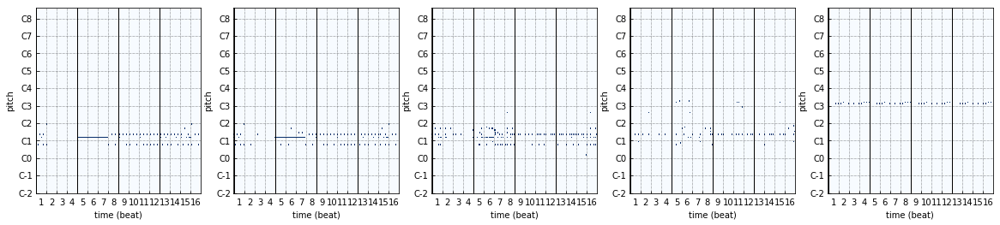

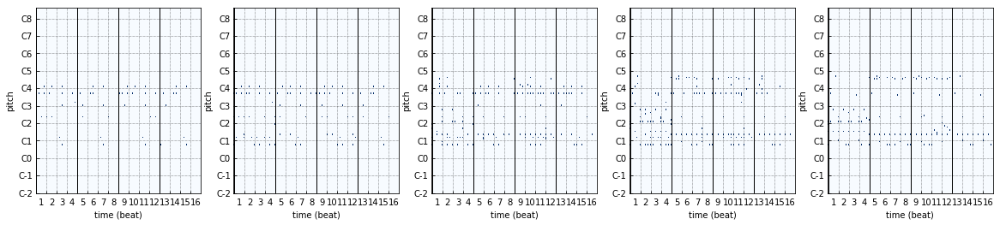

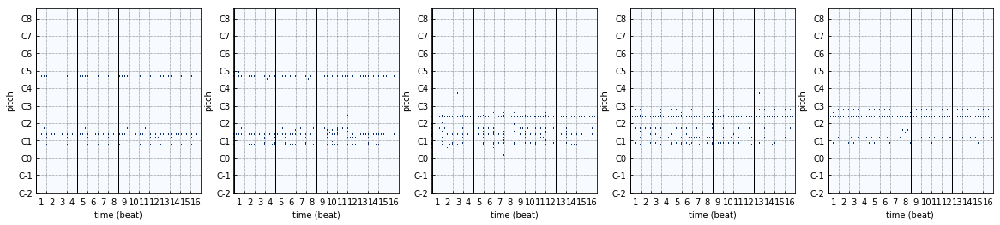

In [5]:
N_DISPLAY = 3
for i in range(N_DISPLAY):
    i0 = random.randint(tracks_np.shape[0])
    i1 = random.randint(tracks_np.shape[0])

    z1 = z[i0].numpy()
    z2 = z[i1].numpy()
    t0 = tracks_np[i0]
    t1 = tracks_np[i1]
    z_interp = vis.interpolate(z1, z2, 5)

    f, axarr = plt.subplots(ncols=5, figsize=(20, 4))

    for i in range(5):
        if i == 0 or i == 4:
            # Just plot the track
            track = vis.to_track((t0 if i == 0 else t1)[:, :, :, 0], is_drum=True)
            audio = vis.synthesize(track)
            vis.ipy_display(audio, '{} (Original)'.format(str(i)))
            to_plot = track
        else:
            zi = z_interp[i]
            zit = torch.tensor(zi).to(z.device).float().unsqueeze(0)
            with torch.no_grad():
                track_recon = (model.decode(zit).numpy() > 0.0)[0]
            track_recon = vis.to_track(track_recon[:, :, :, 0], is_drum=True)
            audio = vis.synthesize(track_recon)
            vis.ipy_display(audio, '{} (Recon)'.format(str(i)))
            to_plot = track_recon
        ppr.plot_pianoroll(axarr[i], to_plot.pianoroll, beat_resolution=12, downbeats=vis.DOWNBEATS)

    plt.show()